In [1]:
# RUN THIS IN THE VERY FIRST CELL
%env HF_HUB_OFFLINE=1

import os
os.environ["HF_HUB_OFFLINE"] = "1"

print("Offline mode forced.")


env: HF_HUB_OFFLINE=1
Offline mode forced.


In [2]:
from models import Qwen3VL
from models.utils import load_all_frames_from_folder, build_chunks_from_full_video

qwen_model = Qwen3VL()

/leonardo/home/userexternal/lzhou001/miniconda3/envs/torch312/lib/python3.12/site-packages/transformers/utils/hub.py:110: FutureWarning: Using `TRANSFORMERS_CACHE` is deprecated and will be removed in v5 of Transformers. Use `HF_HOME` instead.
  warnings.warn(
2026-01-26 15:54:18.983920: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2026-01-26 15:54:19.864856: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
/leonardo/home/userexternal/lzhou001/miniconda3/envs/torch312/lib/python3.12/site-packages/transformers/models/au

Loading checkpoint shards:   0%|          | 0/4 [00:00<?, ?it/s]

In [ ]:
PROMPT_TEMPLATES = {
    "initial_description": (
        "Briefly describe the action/event that just started in the current video segment. "
        "Focus only on the main actions and the progress of the action, ignore meaningless detail to determine the current event, Be careful on their details. "
        "Describe ONLY what is happening in the video segment provided."
    ),

    "validity_check": (
        "Your goal is to identify if the same action is ongoing in the current video segment compared to the previous one. "
        "Given the previous event description:\n\n"
        "{previous_description}\n\n"
        "Question: Is the current video segment still the same stage of the same event?\n"
        "As the last line answer ONLY with 'YES' or 'NO' with no extra characters."
    ),

    "update_description": (
        "Briefly describe the action/event that just started in the current video segment. "
        "Focus only on the main actions and the progress of the action, ignore meaningless detail to determine the current event, Be careful on their details. "
        "Describe ONLY what is happening in the video segment provided."
    ),
}

In [3]:
PROMPT_TEMPLATES = {
        "initial_description": "Briefly describe the new event that just started.",

        "validity_check": "Given the previous event description: {previous_description}, is this the same event or a new one? Respond ONLY with 'YES' or 'NO'.",

        "update_description": "Briefly describe the new event that just started."
    }

In [4]:
from data.annot_utils import load_gt_annotations, get_video_gt_info

BASE_DIR = "data/TAPOS/images/val"
SPLIT_FILE = "random_100_val_split.txt"
GT_ANNOTATION_PATH = "data/TAPOS/tapos_gt_val.pkl"
full_annotations_dict = load_gt_annotations(GT_ANNOTATION_PATH)

Loaded annotations for 1755 videos.


In [5]:
def eval_video(video_path, chunk_size=16, fps=30, verbose=False):
    list_frames, list_files, n_frames = load_all_frames_from_folder(video_path)
    print(f"Loaded {n_frames} frames from {video_path}.")

    chunks = build_chunks_from_full_video(
        total_frames=n_frames,
        chunk_size=chunk_size,
    )

    current_description = None
    timeline = []
    boundaries_frame_indices = []
    boundaries_timestamps = []

    for idx, (start, end) in enumerate(chunks):
        frame_chunk = list_frames[start:end]

        if idx == 0:
            prompt = PROMPT_TEMPLATES["initial_description"]
            current_description = qwen_model.infer(frame_chunk, prompt, sample_fps=fps)
            if verbose:
                print(f"Chunk {idx}, start{start} - end{end}: Initial description: {current_description}")
            timeline.append((start, end, current_description, None))
            continue

        prompt = PROMPT_TEMPLATES["validity_check"].format(
            previous_description=current_description
        )

        answer = qwen_model.infer(frame_chunk, prompt, sample_fps=fps)

        if verbose:
            print(f"Chunk {idx}, start{start} - end{end}: Validity check answer: {answer}")

        # if answer.upper().startswith("YES"):
        #     continue

        if "YES" in answer.upper():
            timeline.append((start, end, "skipped", answer))
            continue

        prompt = PROMPT_TEMPLATES["update_description"].format(
            previous_description=current_description
        )

        current_description = qwen_model.infer(frame_chunk, prompt, sample_fps=fps)

        if verbose:
            print(f"Chunk {idx}, start{start} - end{end}: Updated description: {current_description}")

        timeline.append((start, end, current_description, answer))
        boundaries_frame_indices.append(end - chunk_size/2)
        boundaries_timestamps.append((end - chunk_size/2) / fps) 


    return timeline, boundaries_frame_indices, boundaries_timestamps

In [45]:
import json

# Get FPS for all videos and run eval_video
results = {}

video_paths = []
with open(SPLIT_FILE, "r") as f:
    for line in f:
        video_id = line.strip()
        if not video_id:
            continue
        video_path = os.path.join(BASE_DIR, video_id)
        video_paths.append(video_path)

print(f"Processing {len(video_paths)} videos...")

for video_path in video_paths:
    try:
        video_id = os.path.basename(video_path)
        video_annotations = get_video_gt_info(full_annotations_dict, video_path)
        gt_boundary = video_annotations["boundaries"]
        video_fps = video_annotations["fps"]
        list_frames, list_files, n_frames = load_all_frames_from_folder(video_path)
        
        timeline, boundaries_frame_indices, boundaries_timestamps = eval_video(video_path, chunk_size=16, fps=video_fps)
        results[video_id] = boundaries_frame_indices
    except Exception as e:
        print(f"Error processing video {video_id}: {e}")
        results[video_id] = {"error": str(e)}

Processing 20 videos...
Loaded 390 frames from data/TAPOS/images/val/3HDUOkiQqvw_s00005_15_621_28_639.
Loaded 108 frames from data/TAPOS/images/val/-kdj-g89Vyw_s00001_178_285_181_911.


KeyboardInterrupt: 

In [6]:
import json

# Get FPS for all videos and run eval_video
results = {}

video_paths = []
with open(SPLIT_FILE, "r") as f:
    for line in f:
        video_id = line.strip()
        if not video_id:
            continue
        video_path = os.path.join(BASE_DIR, video_id)
        video_paths.append(video_path)

In [7]:
import json

CHUNK_SIZE = 4

results = {}

video_path = video_paths[8]
print(f"Processing video: {video_path}")
video_id = os.path.basename(video_path)
video_annotations = get_video_gt_info(full_annotations_dict, video_path)
gt_boundary = video_annotations["boundaries"]
video_fps = video_annotations["fps"]
list_frames, list_files, n_frames = load_all_frames_from_folder(video_path)

timeline, boundaries_frame_indices, boundaries_timestamps = eval_video(video_path, chunk_size=CHUNK_SIZE, fps=video_fps)
results[video_id] = boundaries_frame_indices


Processing video: data/TAPOS/images/val/3LUk72wJ9NY_s00025_0_101_4_730


The following generation flags are not valid and may be ignored: ['temperature', 'top_p', 'top_k']. Set `TRANSFORMERS_VERBOSITY=info` for more details.


Loaded 115 frames from data/TAPOS/images/val/3LUk72wJ9NY_s00025_0_101_4_730.


GT Boundaries:  [[95]]


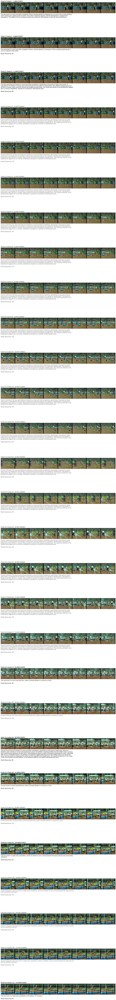

In [8]:
from models.utils import plot_timeline_filmstrip
print("GT Boundaries: ", gt_boundary)
plot_timeline_filmstrip(list_frames, timeline)

In [9]:
import json

CHUNK_SIZE = 16

results = {}

video_path = video_paths[8]
print(f"Processing video: {video_path}")
video_id = os.path.basename(video_path)
video_annotations = get_video_gt_info(full_annotations_dict, video_path)
gt_boundary = video_annotations["boundaries"]
video_fps = video_annotations["fps"]
list_frames, list_files, n_frames = load_all_frames_from_folder(video_path)

timeline, boundaries_frame_indices, boundaries_timestamps = eval_video(video_path, chunk_size=CHUNK_SIZE, fps=video_fps)
results[video_id] = boundaries_frame_indices


Processing video: data/TAPOS/images/val/3LUk72wJ9NY_s00025_0_101_4_730
Loaded 115 frames from data/TAPOS/images/val/3LUk72wJ9NY_s00025_0_101_4_730.


GT Boundaries:  [[95]]


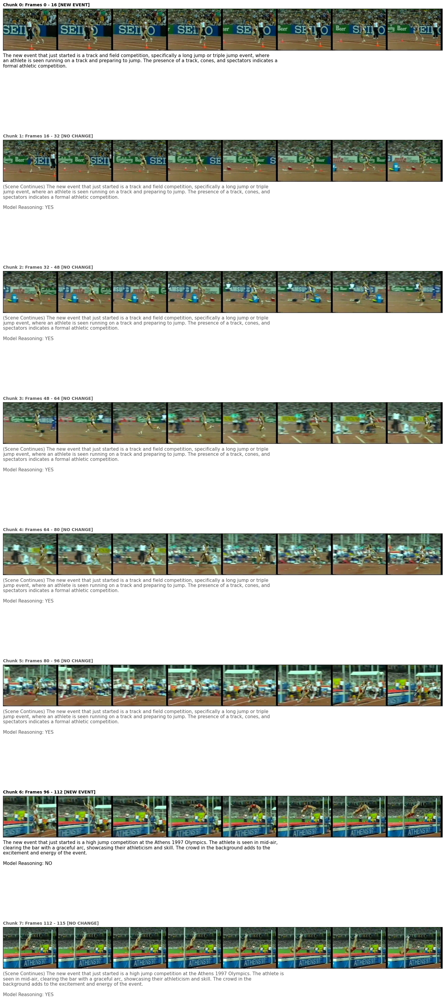

In [10]:
from models.utils import plot_timeline_filmstrip
print("GT Boundaries: ", gt_boundary)
plot_timeline_filmstrip(list_frames, timeline)

In [34]:
results

{'3HDUOkiQqvw_s00005_15_621_28_639': [],
 '-kdj-g89Vyw_s00001_178_285_181_911': [88.0, 100.0],
 '2GB-w6rQgUk_s00001_1_501_50_019': [1447.0],
 '41eaZJJAvcA_s00006_0_901_56_760': [24.0,
  136.0,
  168.0,
  376.0,
  696.0,
  712.0,
  728.0,
  1388.0],
 '-kQZ7nwC8NM_s00020_0_000_5_693': [72.0, 104.0, 134.0],
 '2HvckmRrIuo_s00010_1_604_28_371': [392.0, 584.0],
 '-LKW73dPznY_s00016_21_125_28_835': [24.0,
  88.0,
  104.0,
  120.0,
  136.0,
  152.0,
  168.0,
  184.0],
 '3KydRvV7CAc_s00012_11_138_22_879': [184.0, 216.0, 232.0, 248.0, 328.0],
 '3ws4RPUy2XI_s00018_1_903_6_311': [24.0, 56.0, 88.0, 102.0],
 '4m1xvPeiAcM_s00011_0_301_8_433': [40.0, 136.0, 235.0],
 '3JxjWtB50Vg_s00010_0_000_4_509': [56.0, 72.0],
 '04hncyWNvgo_s00006_3_826_8_659': [56.0, 64.0],
 '21wMSC7_z8U_s00015_0_000_2_005': [24.0, 40.0],
 '3KydRvV7CAc_s00013_8_015_19_536': [184.0,
  200.0,
  248.0,
  264.0,
  296.0,
  312.0,
  328.0],
 '2-rEu-Sjn2Q_s00055_0_000_5_185': [24.0,
  40.0,
  56.0,
  72.0,
  104.0,
  120.0,
  121.0],
 '

In [35]:
ann = get_video_gt_info(full_annotations_dict, "-kdj-g89Vyw_s00001_178_285_181_911")
ann


{'video_id': '-kdj-g89Vyw_s00001_178_285_181_911',
 'boundaries': [[84]],
 'fps': 29.784886927744033}

In [ ]:
from eval import evaluate_gebd, do_eval
results_metrics = {}
rel_dis_thres = [0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.45, 0.5]
for thres in rel_dis_thres:
    res = []
    f1, rec, prec = do_eval(full_annotations_dict, results, threshold=thres)
    res.append((f1, rec, prec))
    results_metrics[thres] = res

In [46]:
for thres, metrics in results_metrics.items():
    print(f"Threshold: {thres}")
    for f1, rec, prec in metrics:
        print(f"F1: {f1:.4f}, Recall: {rec:.4f}, Precision: {prec:.4f}")

Threshold: 0.05
F1: 0.2830, Recall: 0.4412, Precision: 0.2083
Threshold: 0.1
F1: 0.3962, Recall: 0.6176, Precision: 0.2917
Threshold: 0.15
F1: 0.4340, Recall: 0.6765, Precision: 0.3194
Threshold: 0.2
F1: 0.5094, Recall: 0.7941, Precision: 0.3750
Threshold: 0.25
F1: 0.5094, Recall: 0.7941, Precision: 0.3750
Threshold: 0.3
F1: 0.5094, Recall: 0.7941, Precision: 0.3750
Threshold: 0.35
F1: 0.5094, Recall: 0.7941, Precision: 0.3750
Threshold: 0.4
F1: 0.5094, Recall: 0.7941, Precision: 0.3750
Threshold: 0.45
F1: 0.5094, Recall: 0.7941, Precision: 0.3750
Threshold: 0.5
F1: 0.5094, Recall: 0.7941, Precision: 0.3750


In [43]:
results_metrics

{0.05: [(np.float64(0.2830188679245283),
   np.float64(0.4411764705882353),
   np.float64(0.20833333333333334))],
 0.1: [(np.float64(0.39622641509433965),
   np.float64(0.6176470588235294),
   np.float64(0.2916666666666667))],
 0.15: [(np.float64(0.4339622641509434),
   np.float64(0.6764705882352942),
   np.float64(0.3194444444444444))],
 0.2: [(np.float64(0.509433962264151),
   np.float64(0.7941176470588235),
   np.float64(0.375))],
 0.25: [(np.float64(0.509433962264151),
   np.float64(0.7941176470588235),
   np.float64(0.375))],
 0.3: [(np.float64(0.509433962264151),
   np.float64(0.7941176470588235),
   np.float64(0.375))],
 0.35: [(np.float64(0.509433962264151),
   np.float64(0.7941176470588235),
   np.float64(0.375))],
 0.4: [(np.float64(0.509433962264151),
   np.float64(0.7941176470588235),
   np.float64(0.375))],
 0.45: [(np.float64(0.509433962264151),
   np.float64(0.7941176470588235),
   np.float64(0.375))],
 0.5: [(np.float64(0.509433962264151),
   np.float64(0.79411764705882

In [44]:
from eval import do_eval

rel_dis_thres = [0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.45, 0.5]

all_results = {}

for video_id, boundaries_timestamps in results.items():
    # prediction dict for ONE video only
    pred_dict = {
        video_id: boundaries_timestamps
    }

    print(f"Evaluating video {video_id}...")
    print(f"Predicted boundaries (s): {boundaries_timestamps}")
    print(f"gt timestamps: {full_annotations_dict[video_id]}")

    per_video_metrics = {}

    for thres in rel_dis_thres:
        f1, rec, prec = do_eval(
            full_annotations_dict,
            pred_dict,
            threshold=thres
        )

        per_video_metrics[thres] = {
            "f1": f1,
            "recall": rec,
            "precision": prec
        }

    all_results[video_id] = per_video_metrics

Evaluating video 3HDUOkiQqvw_s00005_15_621_28_639...
Predicted boundaries (s): []
gt timestamps: {'num_frames': 390, 'path_video': '/workspace/GEBD/data/TAPOS/videos/3HDUOkiQqvw.mp4', 'fps': 29.958518973728687, 'video_duration': 13.017999999999999, 'path_frame': '/workspace/GEBD/data/TAPOS/images/val/3HDUOkiQqvw_s00005_15_621_28_639', 'f1_consis': [1.0], 'f1_consis_avg': 1.0, 'substages_myframeidx': [[351]], 'substages_timestamps': [[11.716199999999999]]}
Evaluating video -kdj-g89Vyw_s00001_178_285_181_911...
Predicted boundaries (s): [88.0, 100.0]
gt timestamps: {'num_frames': 108, 'path_video': '/workspace/GEBD/data/TAPOS/videos/-kdj-g89Vyw.mp4', 'fps': 29.784886927744033, 'video_duration': 3.6260000000000048, 'path_frame': '/workspace/GEBD/data/TAPOS/images/val/-kdj-g89Vyw_s00001_178_285_181_911', 'f1_consis': [1.0], 'f1_consis_avg': 1.0, 'substages_myframeidx': [[84]], 'substages_timestamps': [[2.8202222222222257]]}
Evaluating video 2GB-w6rQgUk_s00001_1_501_50_019...
Predicted boun

In [45]:
all_results

{'3HDUOkiQqvw_s00005_15_621_28_639': {0.05: {'f1': 0,
   'recall': 0.0,
   'precision': 0},
  0.1: {'f1': 0, 'recall': 0.0, 'precision': 0},
  0.15: {'f1': 0, 'recall': 0.0, 'precision': 0},
  0.2: {'f1': 0, 'recall': 0.0, 'precision': 0},
  0.25: {'f1': 0, 'recall': 0.0, 'precision': 0},
  0.3: {'f1': 0, 'recall': 0.0, 'precision': 0},
  0.35: {'f1': 0, 'recall': 0.0, 'precision': 0},
  0.4: {'f1': 0, 'recall': 0.0, 'precision': 0},
  0.45: {'f1': 0, 'recall': 0.0, 'precision': 0},
  0.5: {'f1': 0, 'recall': 0.0, 'precision': 0}},
 '-kdj-g89Vyw_s00001_178_285_181_911': {0.05: {'f1': np.float64(0.6666666666666666),
   'recall': np.float64(1.0),
   'precision': np.float64(0.5)},
  0.1: {'f1': np.float64(0.6666666666666666),
   'recall': np.float64(1.0),
   'precision': np.float64(0.5)},
  0.15: {'f1': np.float64(0.6666666666666666),
   'recall': np.float64(1.0),
   'precision': np.float64(0.5)},
  0.2: {'f1': np.float64(0.6666666666666666),
   'recall': np.float64(1.0),
   'precision': 

In [5]:
#VIDEO_PATH = "data/TAPOS/images/val/6OLDzu5TmNc_s00003_0_000_4_425"
VIDEO_PATH = "data/TAPOS/images/val/3HDUOkiQqvw_s00005_15_621_28_639"

video_annotations_dict = get_video_gt_info(full_annotations_dict, VIDEO_PATH)
video_annotations_dict

{'video_id': '3HDUOkiQqvw_s00005_15_621_28_639',
 'boundaries': [[351]],
 'fps': 29.958518973728687}

In [28]:
list_frames, list_files, n_frames = load_all_frames_from_folder(VIDEO_PATH)
print(f"Loaded {n_frames} frames from {VIDEO_PATH}.")
print(f"GT Boundaries (frame indices): {gt_boundary}")

chunks = build_chunks_from_full_video(
    total_frames=n_frames,
    chunk_size=16,
)

current_description = None
timeline = []

for idx, (start, end) in enumerate(chunks):
    frame_chunk = list_frames[start:end]

    if idx == 0:
        prompt = PROMPT_TEMPLATES["initial_description"]
        current_description = qwen_model.infer(frame_chunk, prompt, sample_fps=32)
        print(f"Chunk {idx}, start{start} - end{end}: Initial description: {current_description}")
        timeline.append((start, end, current_description, None))
        continue

    prompt = PROMPT_TEMPLATES["validity_check"].format(
        previous_description=current_description
    )

    answer = qwen_model.infer(frame_chunk, prompt, sample_fps=32)

    print(f"Chunk {idx}, start{start} - end{end}: Validity check answer: {answer}")

    # if answer.upper().startswith("YES"):
    #     continue

    if "YES" in answer.upper():
        timeline.append((start, end, "skipped", answer))
        continue

    prompt = PROMPT_TEMPLATES["update_description"].format(
        previous_description=current_description
    )

    current_description = qwen_model.infer(frame_chunk, prompt, sample_fps=32)

    print(f"Chunk {idx}, start{start} - end{end}: Updated description: {current_description}")

    timeline.append((start, end, current_description, answer))

Loaded 1396 frames from data/TAPOS/images/val/41eaZJJAvcA_s00006_0_901_56_760.
GT Boundaries (frame indices): [[60, 77, 122, 237, 257, 650, 940, 958, 1343]]
Chunk 0, start0 - end16: Initial description: A gymnast is performing on the high bar. He is swinging back and forth, then he does a flip and lands on the mat.
Chunk 1, start16 - end32: Validity check answer: NO
Chunk 1, start16 - end32: Updated description: A gymnast in a red and yellow uniform is performing on the parallel bars. He is holding onto the bars with his hands and is in a straight position with his legs extended. He is looking straight ahead.
Chunk 2, start32 - end48: Validity check answer: YES
Chunk 3, start48 - end64: Validity check answer: YES
Chunk 4, start64 - end80: Validity check answer: YES
Chunk 5, start80 - end96: Validity check answer: YES
Chunk 6, start96 - end112: Validity check answer: YES
Chunk 7, start112 - end128: Validity check answer: YES
Chunk 8, start128 - end144: Validity check answer: NO
Chunk 8,

Showing first 40 chunks (out of 91)...


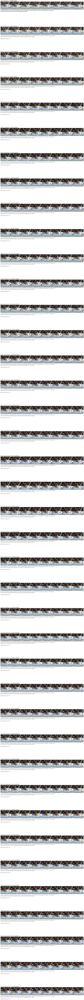

In [26]:
from models.utils import plot_timeline_filmstrip
plot_timeline_filmstrip(list_frames, timeline)